In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

In [46]:
sellin = pd.read_csv("datasets/sell-in.csv", sep='\t')
productos = pd.read_csv("datasets/tb_productos.csv", sep='\t')
stocks = pd.read_csv("datasets/tb_stocks.csv", sep='\t')

In [3]:
# Verificación inicial
print(f"Sell-In: {sellin.shape[0]} filas y {sellin.shape[1]} columnas")
print(f"Productos: {productos.shape[0]} filas y {productos.shape[1]} columnas")
print(f"Stocks: {stocks.shape[0]} filas y {stocks.shape[1]} columnas")

Sell-In: 2945818 filas y 7 columnas
Productos: 1262 filas y 6 columnas
Stocks: 13691 filas y 3 columnas


In [4]:
# 3. MERGE INICIAL
df = sellin.merge(productos, on="product_id", how="left")
df = df.merge(stocks, on=["product_id", "periodo"], how="left")
print(f"Ventas-Productos-Stocks: {df.shape[0]} filas y {df.shape[1]} columnas")

Ventas-Productos-Stocks: 2988650 filas y 13 columnas


In [5]:
productos_clean = productos.drop_duplicates(subset=['product_id'], keep='first')
print(productos_clean.shape)

(1251, 6)


In [6]:
df = sellin.merge(productos_clean, on="product_id", how="left")
df = df.merge(stocks, on=["product_id", "periodo"], how="left")
print(sellin.shape)
print(df.shape)

(2945818, 7)
(2945818, 13)


In [7]:
df['periodo_dt'] = pd.to_datetime(df['periodo'].astype(str), format='%Y%m')

# Clientes

### Clientes que más compraron toneladas

In [141]:
# Volumen total por cliente
tn_por_cliente_menos = (
    df.groupby('customer_id')['tn']
    .sum()
    .sort_values(ascending=False)
    .reset_index()
)

# Renombrar columna
tn_por_cliente_menos.columns = ['customer_id', 'total_toneladas']

# Calcular total global de toneladas
total_global = tn_por_cliente_menos['total_toneladas'].sum()

# Agregar porcentaje y acumulado
tn_por_cliente_menos['porcentaje_tn'] = (tn_por_cliente_menos['total_toneladas'] / total_global) * 100
tn_por_cliente_menos['porcentaje_acumulado'] = tn_por_cliente_menos['porcentaje_tn'].cumsum()

# Calcular cantidad de compras por cliente
cantidad_compras = df.groupby('customer_id').size().reset_index(name='cantidad_compras')

# Calcular cantidad de productos distintos por cliente
productos_distintos = df.groupby('customer_id')['product_id'].nunique().reset_index(name='productos_distintos')

# Unir todo
tn_por_cliente_menos = tn_por_cliente_menos.merge(cantidad_compras, on='customer_id', how='left')
tn_por_cliente_menos = tn_por_cliente_menos.merge(productos_distintos, on='customer_id', how='left')

# Mostrar
# display(tn_por_cliente_menos.sort_values(by='productos_distintos', ascending=False).head(13))
display(tn_por_cliente_menos.head(13))

,customer_id,total_toneladas,porcentaje_tn,porcentaje_acumulado,cantidad_compras,productos_distintos
0,10001,109203.60059,8.241852,8.241852,24914,1094
1,10002,77333.16887,5.836516,14.078368,23224,1006
2,10003,71375.91941,5.386908,19.465276,23927,1041
3,10004,63065.94269,4.759735,24.225011,24234,1033
4,10005,51467.04585,3.884339,28.109350,21189,806
5,10006,49779.23364,3.756956,31.866305,18077,810
6,10007,43740.39629,3.301190,35.167496,23257,1019
7,10008,41962.99046,3.167045,38.334541,9028,381
8,10009,38742.71591,2.924004,41.258545,16415,694
9,10011,34675.44337,2.617037,43.875582,17019,806


### Clientes que menos compraron toneladas

In [70]:
# Volumen total por cliente
tn_por_cliente_menos = (
    df.groupby('customer_id')['tn']
    .sum()
    .sort_values(ascending=True)
    .reset_index()
)

# Renombrar columna
tn_por_cliente_menos.columns = ['customer_id', 'total_toneladas']

# Calcular total global de toneladas
total_global = tn_por_cliente_menos['total_toneladas'].sum()

# Agregar porcentaje y acumulado
tn_por_cliente_menos['porcentaje_tn'] = (tn_por_cliente_menos['total_toneladas'] / total_global) * 100
tn_por_cliente_menos['porcentaje_acumulado'] = tn_por_cliente_menos['porcentaje_tn'].cumsum()

# Calcular cantidad de compras por cliente
cantidad_compras = df.groupby('customer_id').size().reset_index(name='cantidad_compras')

# Calcular cantidad de productos distintos por cliente
productos_distintos = df.groupby('customer_id')['product_id'].nunique().reset_index(name='productos_distintos')

# Unir todo
tn_por_cliente_menos = tn_por_cliente_menos.merge(cantidad_compras, on='customer_id', how='left')
tn_por_cliente_menos = tn_por_cliente_menos.merge(productos_distintos, on='customer_id', how='left')

# Mostrar
display(tn_por_cliente_menos.loc[12:22])


,customer_id,total_toneladas,porcentaje_tn,porcentaje_acumulado,cantidad_compras,productos_distintos
12,10625,0.93102,0.000070,0.000399,257,158
13,10559,1.02801,0.000078,0.000477,5,5
14,10577,1.49320,0.000113,0.000590,5,5
15,10615,1.78976,0.000135,0.000725,101,57
16,10614,1.95829,0.000148,0.000873,578,270
17,10613,2.05578,0.000155,0.001028,138,138
18,10599,2.08315,0.000157,0.001185,7,7
19,10611,2.25020,0.000170,0.001355,100,50
20,10610,2.31364,0.000175,0.001529,71,44
21,10609,2.33024,0.000176,0.001705,64,64


# Grafico <Periodo, Cliente, Producto>

In [120]:
prod_x_cust = df[df['customer_id'] == 10559]['product_id'].unique()
sorted(prod_x_cust)[:20]

[20191, 20313, 20479, 20515, 20657]

In [131]:
import matplotlib.pyplot as plt
import pandas as pd
import math

def graficar_cliente_y_productos(df, cliente_id, lista_productos):
    """
    Grafica toneladas compradas por mes para varios productos de un cliente,
    alineando en el eje temporal global y respetando el mes real de inicio de ventas.
    """

    # Copiar y asegurar formato datetime
    df = df.copy()
    df['periodo_dt'] = pd.to_datetime(df['periodo'].astype(str), format='%Y%m')

    # Crear eje temporal global y mapeo de fechas a mes relativo
    fechas_maestro = pd.date_range(start=df['periodo_dt'].min(), end=df['periodo_dt'].max(), freq='MS')
    mapa_mes_relativo = {fecha: i + 1 for i, fecha in enumerate(fechas_maestro)}

    n = len(lista_productos)
    n_cols = 2
    n_rows = math.ceil(n / n_cols)

    fig, axes = plt.subplots(n_rows, n_cols, figsize=(14, 4 * n_rows), sharey=False)
    axes = axes.flatten()

    for i, producto_id in enumerate(lista_productos):
        df_filtro = df[(df['customer_id'] == cliente_id) & (df['product_id'] == producto_id)].copy()

        if df_filtro.empty:
            continue

        # Agrupar por periodo_dt y reindexar con el eje global
        serie = (
            df_filtro.groupby('periodo_dt')['tn']
            .sum()
            .reindex(fechas_maestro, fill_value=0)
            .reset_index()
        )

        # Asignar nombre correcto a la columna de fechas
        serie.columns = ['periodo_dt', 'tn']

        # Crear columna de mes relativo
        serie['mes_relativo'] = serie['periodo_dt'].map(mapa_mes_relativo)

        # Graficar
        ax = axes[i]
        ax.bar(serie['mes_relativo'], serie['tn'], color='skyblue')
        ax.set_title(f'Cliente {cliente_id} | Producto {producto_id}')
        ax.set_xlabel('Mes relativo')
        ax.set_ylabel('Toneladas')

        # Marcar enero con líneas verticales punteadas
        eneros = [m for m in serie['periodo_dt'] if m.month == 1]
        for enero in eneros:
            ax.axvline(x=mapa_mes_relativo[enero], color='gray', linestyle='--', linewidth=0.8)

        ax.set_xticks(serie['mes_relativo'])
        ax.grid(axis='y', linestyle='--', alpha=0.5)
        ax.tick_params(axis='x', rotation=45)
    # Eliminar subplots vacíos
    for j in range(i + 1, len(axes)):
        fig.delaxes(axes[j])

    plt.tight_layout()
    plt.show()




In [122]:
df[(df['customer_id']==10559)&(df['product_id']==20191)]['periodo']

2869086    201911
Name: periodo, dtype: int64

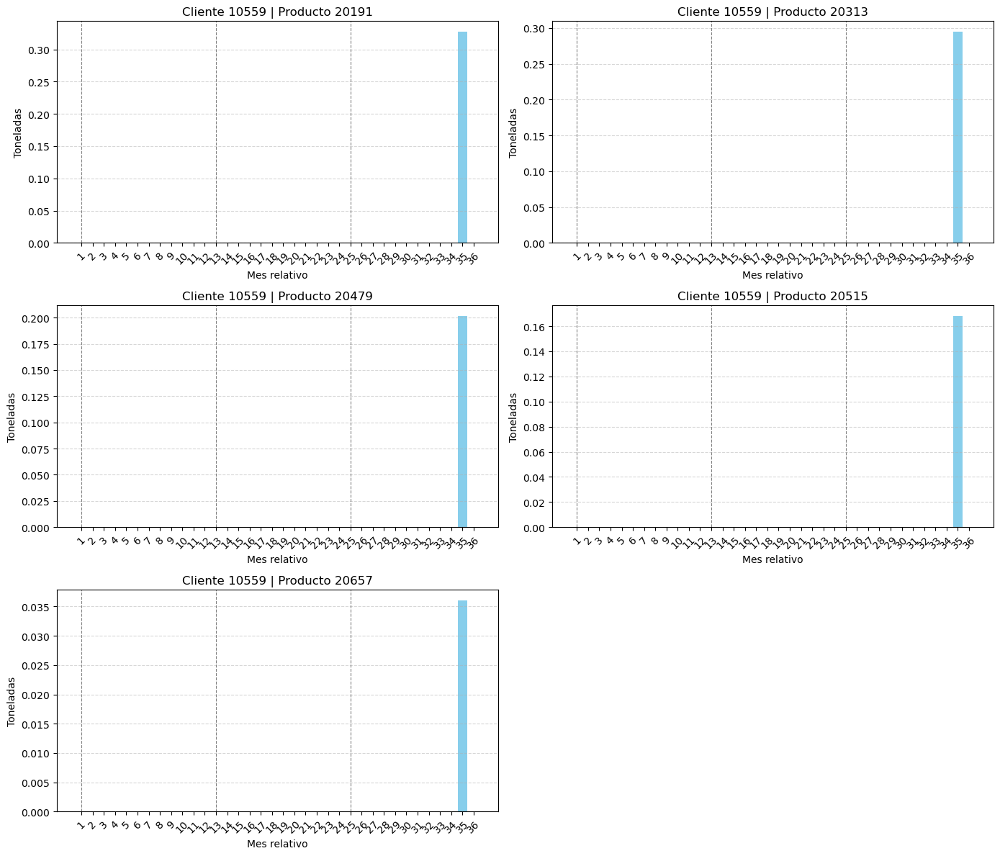

In [132]:
# Asegurar que 'periodo' esté en datetime
# df['periodo_dt'] = pd.to_datetime(df['periodo'].astype(str), format='%Y%m')
graficar_cliente_y_productos(df, 10559,[20191, 20313, 20479, 20515, 20657] )

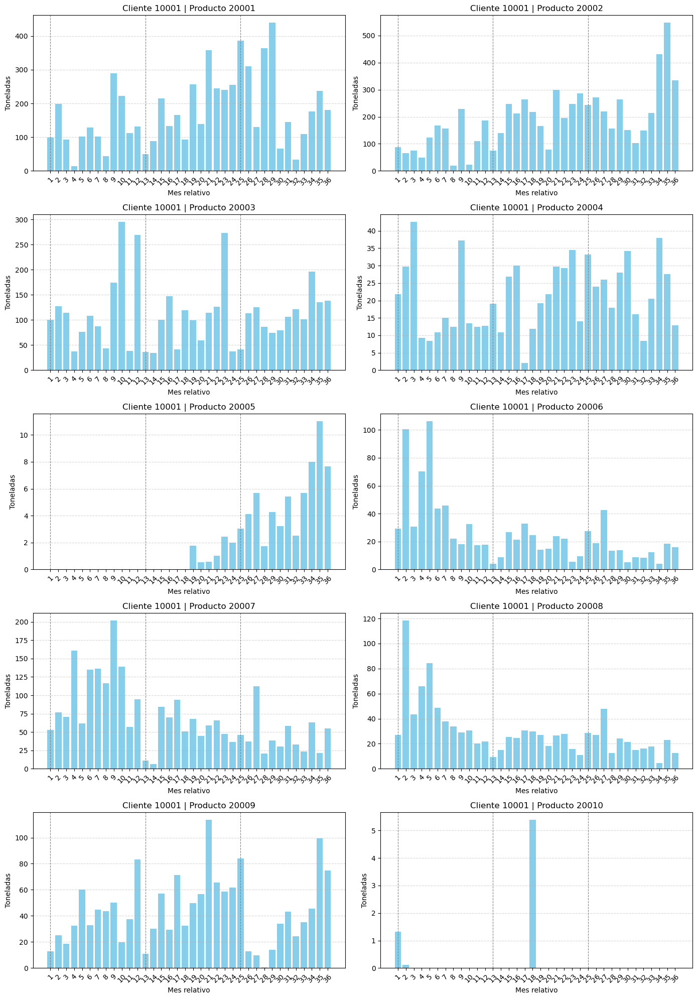

In [133]:
graficar_cliente_y_productos(df, cliente_id=10001, lista_productos=[20001, 20002, 20003, 20004, 20005, 20006, 20007, 20008, 20009, 20010]) # cliente, producto

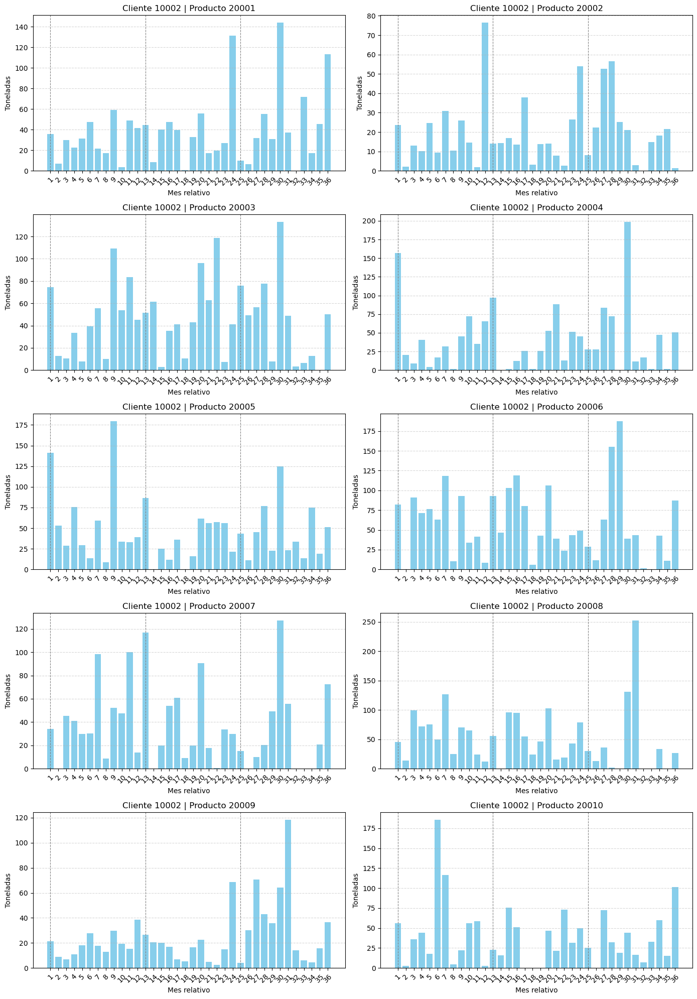

In [134]:
graficar_cliente_y_productos(df, cliente_id=10002, lista_productos=[20001, 20002, 20003, 20004, 20005, 20006, 20007, 20008, 20009, 20010]) # cliente, producto

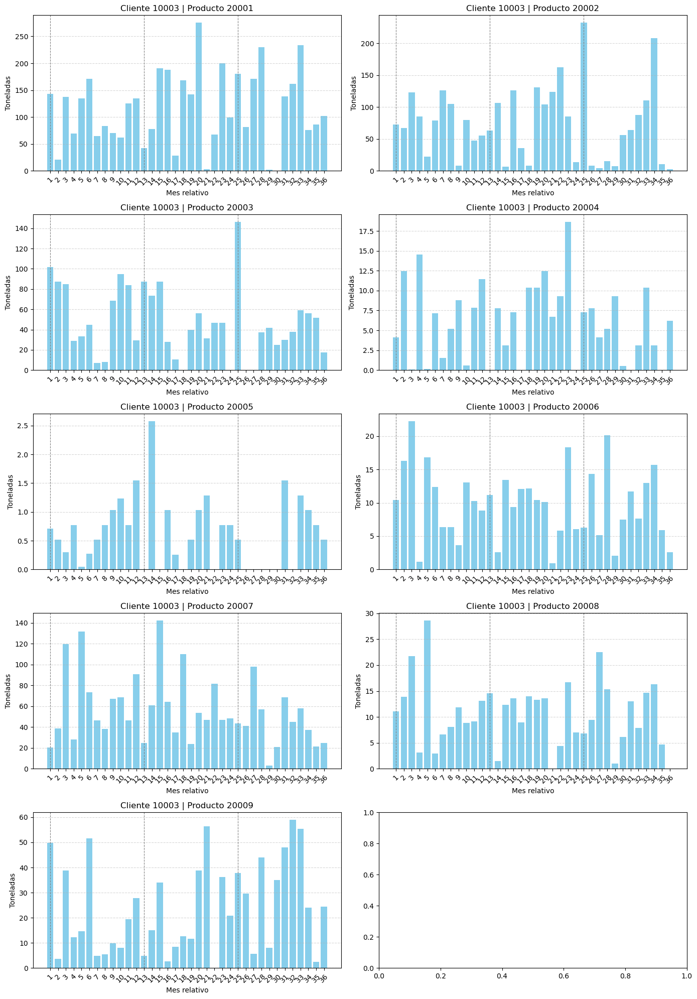

In [135]:
graficar_cliente_y_productos(df, cliente_id=10003, lista_productos=[20001, 20002, 20003, 20004, 20005, 20006, 20007, 20008, 20009, 20010]) # cliente, producto

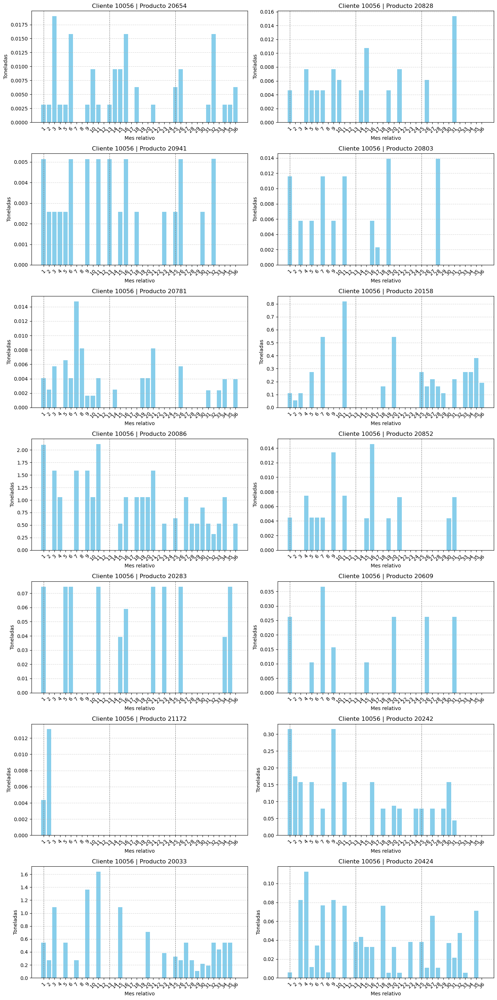

In [136]:
# df[df['customer_id']==10056]['product_id'].unique().tolist()
graficar_cliente_y_productos(df, cliente_id=10056, lista_productos=[20654,
 20828,
 20941,
 20803,
 20781,
 20158,
 20086,
 20852,
 20283,
 20609,
 21172,
 20242,
 20033,
 20424]) # cliente, producto

In [73]:
# A nivel producto
ventas_producto = df.groupby('product_id')['tn'].sum().reset_index()

# A nivel cliente-producto
ventas_cliente_producto = df.groupby(['customer_id', 'product_id'])['tn'].sum().reset_index()


✅ 1. ¿Cuántos productos tienen más de N clientes?

In [82]:
# Número de clientes por producto
clientes_por_producto = df.groupby('product_id')['customer_id'].nunique().reset_index(name='n_clientes')

# Filtrar productos con más de N clientes
N = 500
productos_mas_de_N_clientes = clientes_por_producto[clientes_por_producto['n_clientes'] > N]

print(f"📦 Productos con más de {N} clientes: {productos_mas_de_N_clientes.shape[0]}")


📦 Productos con más de 500 clientes: 20


✅ 2. ¿Cuántos clientes compran más de M productos?

In [86]:
# Número de productos distintos por cliente
productos_por_cliente = df.groupby('customer_id')['product_id'].nunique().reset_index(name='n_productos')

# Filtrar clientes con más de M productos
M = 1000
clientes_mas_de_M_productos = productos_por_cliente[productos_por_cliente['n_productos'] > M]

print(f"👥 Clientes que compraron más de {M} productos: {clientes_mas_de_M_productos.shape[0]}")


👥 Clientes que compraron más de 1000 productos: 74


✅ 3. ¿Qué proporción del total de toneladas se explica con los top 20 productos?

In [ ]:
# Total de toneladas por producto
tn_por_producto = df.groupby('product_id')['tn'].sum().reset_index().sort_values(by='tn', ascending=False)

# Calcular el total de toneladas y top 20
total_tn = tn_por_producto['tn'].sum()
top_20_tn = tn_por_producto.head(800)['tn'].sum()
proporcion_top_20 = top_20_tn / total_tn * 100

print(f"🔝 Los 800 productos más vendidos explican el {proporcion_top_20:.2f}% del total de toneladas.")


🔝 Los 50 productos más vendidos explican el 99.19% del total de toneladas.


✅ 4. ¿Qué porcentaje de combinaciones <customer, product> tienen pocas compras?

💡 Criterio: “pocas compras” puede ser menos de 3 meses con ventas

In [108]:
# Contar cuántos meses con ventas tiene cada combinación customer-product
historial_cp = df[df['tn'] > 0].groupby(['customer_id', 'product_id'])['periodo'].nunique().reset_index(name='meses_con_venta')

# Total de combinaciones
total_combinaciones = historial_cp.shape[0]

# Filtrar las esporádicas (menos de 3 meses)
esporadicas = historial_cp[historial_cp['meses_con_venta'] == 2]
porcentaje_esporadicas = esporadicas.shape[0] / total_combinaciones * 100

print(f"📉 El {porcentaje_esporadicas:.2f}% de las combinaciones cliente-producto tienen menos de 3 meses de ventas.")


📉 El 12.25% de las combinaciones cliente-producto tienen menos de 3 meses de ventas.


In [140]:
df['product_id'].nunique()

1233

In [109]:
esporadicas

,customer_id,product_id,meses_con_venta
39,10001,20041,2
678,10001,20728,2
810,10001,20874,2
850,10001,20929,2
859,10001,20940,2
...,...,...,...
374400,10635,20353,2
374402,10635,20382,2
374413,10635,20672,2
374418,10635,20810,2


In [105]:
print(esporadicas.shape)
print(historial_cp['customer_id'].nunique())
print(df['customer_id'].nunique())

(71567, 3)
597
597


quiero identificar todos aquellos que compraron una sola vez un producto

In [ ]:
df[df['product_id']==20001]['customer_id'].nunique()

444

In [150]:
# Filtrar el DataFrame por el producto deseado
df_producto = df[df['product_id'] == 20001]

# Agrupar por cliente y calcular cantidad de compras, toneladas totales y último período de compra
resumen_clientes = (
    df_producto
    .groupby('customer_id')
    .agg(
        cantidad_compras=('periodo', 'count'),
        toneladas_totales=('tn', 'sum'),
        ultimo_periodo=('periodo', 'max')  # 👉 último mes en que compró
    )
    .reset_index()
    .sort_values(by='toneladas_totales', ascending=False)
)

display(resumen_clientes)


,customer_id,cantidad_compras,toneladas_totales,ultimo_periodo
3,10004,36,7740.34113,201912
0,10001,36,6347.96490,201912
2,10003,35,4162.77308,201912
6,10007,36,3947.17979,201912
12,10013,36,3772.14516,201912
...,...,...,...,...
224,10239,1,0.03358,201708
419,10514,1,0.02240,201803
380,10440,1,0.02240,201907
438,10570,1,0.02239,201701


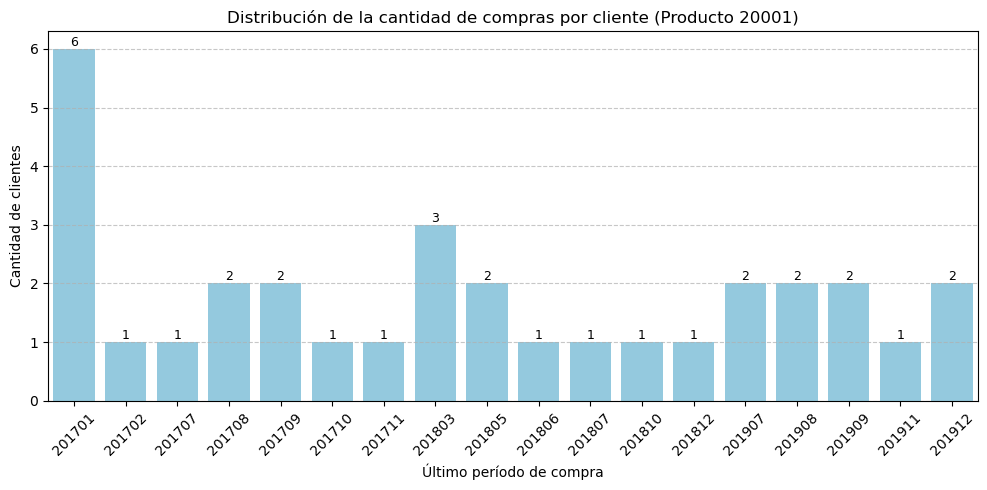

In [155]:
mask = resumen_clientes['cantidad_compras'] == 1
compra_1 = resumen_clientes[mask]

plt.figure(figsize=(10, 5))
ax = sns.countplot(data=compra_1, x='ultimo_periodo', color='skyblue')

# Títulos y etiquetas
plt.title("Distribución de la cantidad de compras por cliente (Producto 20001)")
plt.xlabel("Último período de compra")
plt.ylabel("Cantidad de clientes")
plt.xticks(rotation=45)  # 👉 Rotar etiquetas del eje X
plt.grid(axis='y', linestyle='--', alpha=0.7)

# Agregar los números encima de cada barra
for p in ax.patches:
    altura = p.get_height()
    ax.annotate(f'{int(altura)}', (p.get_x() + p.get_width() / 2., altura),
                ha='center', va='bottom', fontsize=9)

plt.tight_layout()
plt.show()


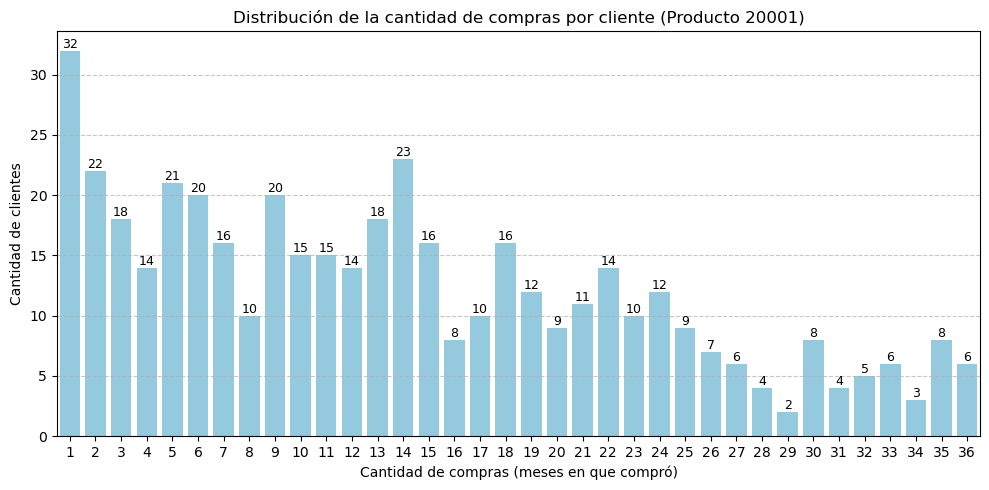

In [151]:
plt.figure(figsize=(10, 5))
ax = sns.countplot(data=resumen_clientes, x='cantidad_compras', color='skyblue')

# Títulos y etiquetas
plt.title("Distribución de la cantidad de compras por cliente (Producto 20001)")
plt.xlabel("Cantidad de compras (meses en que compró)")
plt.ylabel("Cantidad de clientes")
plt.xticks(rotation=0)
plt.grid(axis='y', linestyle='--', alpha=0.7)

# Agregar los números encima de cada barra
for p in ax.patches:
    altura = p.get_height()
    ax.annotate(f'{int(altura)}', (p.get_x() + p.get_width() / 2., altura),
                ha='center', va='bottom', fontsize=9)

plt.tight_layout()
plt.show()


In [162]:
mask = (resumen_clientes['cantidad_compras'] == 36)
resumen_clientes[mask].shape


(6, 4)

In [163]:
df_pivot = df.pivot_table(index='periodo', columns='product_id', values='tn', aggfunc='sum').fillna(0)
correlaciones = df_pivot.corr()

In [166]:
correlaciones[20001].sort_values(ascending=False)

product_id
20001    1.000000
21031    0.609285
20459    0.608048
21246    0.603359
21244    0.603200
           ...   
20819   -0.467866
21059   -0.468606
21158   -0.471991
20690   -0.474606
20880   -0.504968
Name: 20001, Length: 1233, dtype: float64

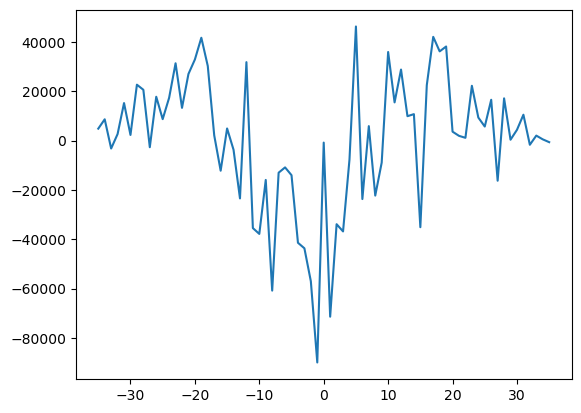

In [167]:
from scipy.signal import correlate
serie_a = df_pivot[20001]  # producto estrella
serie_b = df_pivot[20123]  # otro producto

correlacion = correlate(serie_a - serie_a.mean(), serie_b - serie_b.mean(), mode='full')
lags = range(-len(serie_a)+1, len(serie_a))

plt.plot(lags, correlacion)

In [176]:
import pandas as pd
from sklearn.cluster import AgglomerativeClustering


# Asegurar que 'periodo' es entero tipo yyyymm y que 'tn' existe
df['periodo'] = df['periodo'].astype(int)

# Pivotear para obtener una matriz de productos x tiempo
df_pivot = df.pivot_table(index='periodo', columns='product_id', values='tn', aggfunc='sum').fillna(0)

# Calcular la matriz de correlación entre productos
cor_matrix = df_pivot.corr(method='pearson')

# Convertimos la matriz de correlación a una matriz de distancia
distance_matrix = 1 - cor_matrix.abs()

# Clustering jerárquico con 10 grupos
model = AgglomerativeClustering(n_clusters=10,  linkage='average')
labels = model.fit_predict(distance_matrix)

# Asignar etiquetas a cada serie (producto)
clusters = pd.DataFrame({'product_id': cor_matrix.columns, 'cluster': labels})

# Mostrar los primeros resultados
print(clusters.head())


   product_id  cluster
0       20001        0
1       20002        4
2       20003        0
3       20004        0
4       20005        0


In [177]:
clusters['cluster'].value_counts()

cluster
4    380
0    272
9    127
2    105
3     97
7     84
1     68
5     50
6     33
8     17
Name: count, dtype: int64

In [179]:
from sklearn.cluster import AgglomerativeClustering
# Paso 1
df_pivot = df.pivot_table(index='periodo', columns='product_id', values='tn', aggfunc='sum').fillna(0)

# Paso 2
cor_matrix = df_pivot.corr(method='pearson')

# Paso 3
distance_matrix = 1 - cor_matrix.abs()
model = AgglomerativeClustering(n_clusters=10, metric='precomputed', linkage='average')
labels = model.fit_predict(distance_matrix)

# Crear DataFrame de clusters
df_clusters = pd.DataFrame({'product_id': cor_matrix.columns, 'cluster': labels})
df_clusters['cluster'].value_counts()

cluster
0    1052
1      74
9      19
8      17
4      17
5      17
3      12
6      11
7      11
2       3
Name: count, dtype: int64

In [182]:
# Convertir 'periodo' a tipo datetime (asumiendo formato YYYYMM)
df['periodo'] = pd.to_datetime(df['periodo'].astype(str), format='%Y%m')

# Pivotear para obtener un dataframe: filas = periodo, columnas = product_id, valores = tn
df_pivot = df.pivot_table(index='periodo', columns='product_id', values='tn', aggfunc='sum').fillna(0)

# Función para agregar features de correlación cruzada
def add_cross_correlation_features(df, window=12):
    """
    Añade features de correlación cruzada entre productos en una ventana móvil.
    """
    df_corr = df.copy()
    
    for product in df.columns:
        for other_product in df.columns:
            if product != other_product:
                corr_feature_name = f"{product}_corr_{other_product}"
                df_corr[corr_feature_name] = (
                    df[product].rolling(window).corr(df[other_product])
                )
    
    df_corr = df_corr.dropna()
    return df_corr

# Aplicar la función
df_corr_features = add_cross_correlation_features(df_pivot, window=12)



C:\Users\iparra\AppData\Local\Temp\ipykernel_15284\217222219.py:18: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_corr[corr_feature_name] = (
C:\Users\iparra\AppData\Local\Temp\ipykernel_15284\217222219.py:18: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_corr[corr_feature_name] = (
C:\Users\iparra\AppData\Local\Temp\ipykernel_15284\217222219.py:18: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns 

KeyboardInterrupt: 

# Dataset: <periodo, producto>

### Si hace falta llenar periodos vacios para un producto  usar este codigo

In [165]:
# Suponemos que ya tenés cargado tu DataFrame `df` con columnas: periodo (AAAAMM), customer_id, product_id, tn
# Convertimos periodo a datetime
df["periodo_dt"] = pd.to_datetime(df["periodo"].astype(str), format="%Y%m")

# Paso 2: Determinar periodo de vida útil de cada producto
vida_producto = df.groupby("product_id")["periodo_dt"].agg(["min", "max"]).reset_index()

# Expandimos cada producto con todos los periodos de su vida útil
periodos_producto = []
for _, row in vida_producto.iterrows():
    periodos = pd.date_range(start=row["min"], end=row["max"], freq="MS")
    for p in periodos:
        periodos_producto.append((p, row["product_id"]))
df_producto_periodo = pd.DataFrame(periodos_producto, columns=["periodo_dt", "product_id"])
df_producto_periodo["periodo"] = df_producto_periodo["periodo_dt"].dt.strftime("%Y%m").astype(int)
display(df_producto_periodo.tail())
print(df_producto_periodo.shape)


,periodo_dt,product_id,periodo
31517,2017-01-01,21295,201701
31518,2017-08-01,21296,201708
31519,2017-01-01,21297,201701
31520,2017-08-01,21298,201708
31521,2017-08-01,21299,201708


(31522, 3)


In [166]:
ts_2 = df.copy()
# Agregar los datos por periodo y product_id para obtener la serie temporal
ts_2 = ts_2.groupby(['periodo', 'product_id'])['tn'].sum().reset_index()

ts_2.shape

(31243, 3)

In [168]:
# Paso 5: Unir con las toneladas efectivamente vendidas (tn)
df_merge = df_producto_periodo.merge(ts_2[["periodo", "product_id", "tn"]],
                             on=["periodo", "product_id"],
                             how="left")
df_merge["tn"] = df_merge["tn"].fillna(0)

df_merge["tn"].shape

(31522,)

In [181]:
sellin.columns

Index(['periodo', 'customer_id', 'product_id', 'plan_precios_cuidados',
       'cust_request_qty', 'cust_request_tn', 'tn'],
      dtype='object')

In [ ]:
# Unir las categorías de productos desde el archivo tb_productos
df_merge = df_merge.merge(productos[['product_id', 'cat1', 'cat2', 'cat3','brand','sku_size']], on='product_id', how='left')
df_merge = df_merge.merge(stocks[['product_id', 'periodo', 'stock_final']], on=['product_id', 'periodo'], how='left')
# df_merge = df_merge.merge(sellin[['product_id', 'periodo', 'plan_precios_cuidados', 'cust_request_qty','cust_request_tn']], on=['product_id', 'periodo', 'customer_id'], how='left')

##########################################################################################################
##########################################################################################################
##########################################################################################################
#### HAY QUE SUMARIZAR: 'plan_precios_cuidados', 'cust_request_qty','cust_request_tn' ####################
##########################################################################################################

### Si no hace falta ir acumulando productos usar este codigo

In [ ]:
ts_2 = df.copy()



# Agregar los datos por periodo y product_id para obtener la serie temporal
ts_2 = ts_2.groupby(['periodo', 'product_id'])['tn'].sum().reset_index()

# Unir las categorías de productos desde el archivo tb_productos
ts_2 = ts_2.merge(productos[['product_id', 'cat1', 'cat2', 'cat3','brand','sku_size']], on='product_id', how='left')
ts_2 = ts_2.merge(stocks[['product_id', 'periodo', 'stock_final']], on=['product_id', 'periodo'], how='left')

# Convertir el periodo a formato datetime
ts_2['periodo_dt'] = pd.to_datetime(df['periodo'], format='%Y%m')

# Convertir las columnas de categoría a tipo 'category' para que las detecte LGBM
ts_2['cat1'] = ts_2['cat1'].astype('category')
ts_2['cat2'] = ts_2['cat2'].astype('category')
ts_2['cat3'] = ts_2['cat3'].astype('category')
ts_2['brand'] = ts_2['brand'].astype('category')
ts_2['sku_size'] = ts_2['sku_size'].astype('category')

# Crear características adicionales
ts_2['crisis'] = (ts_2['periodo_dt'].dt.year == 2019) & (ts_2['periodo_dt'].dt.month == 8)
ts_2['quarter'] = ts_2['periodo_dt'].dt.quarter
ts_2['month'] = ts_2['periodo_dt'].dt.month
ts_2['year'] = ts_2['periodo_dt'].dt.year
ts_2['season'] = ts_2['periodo_dt'].apply(lambda x: 1 if x.month in [6, 7, 8] else 0)
ts_2['tn_diff'] = ts_2.groupby('product_id')['tn'].diff()
ts_2['rolling_mean'] = ts_2.groupby('product_id')['tn'].rolling(window=3).mean().reset_index(level=0, drop=True)
ts_2['interaction'] = ts_2['year'] * ts_2['month']

# Normalización por producto
ts_2['tn_norm'] = ts_2.groupby('product_id')['tn'].transform(lambda x: (x - x.mean()) / x.std())

# Agregar lags a los datos
for lag in range(1, 13):
    ts_2[f'tn_lag_{lag}'] = ts_2.groupby('product_id')['tn'].shift(lag)

# Identificar el primer y último periodo de ventas para cada producto
ts_2['first_sale'] = ts_2.groupby('product_id')['periodo_dt'].transform('min')
ts_2['last_sale'] = ts_2.groupby('product_id')['periodo_dt'].transform('max')

# Calcular el tiempo desde la primera venta para cada registro
ts_2['months_since_launch'] = (ts_2['periodo_dt'] - ts_2['first_sale']).dt.days // 30  # en meses

# Crear una categoría de madurez basada en el tiempo desde la primera venta
conditions = [
    (ts_2['months_since_launch'] < 6),
    (ts_2['months_since_launch'] >= 6) & (ts_2['months_since_launch'] < 18),
    (ts_2['months_since_launch'] >= 18) & (ts_2['months_since_launch'] < 30),
    (ts_2['months_since_launch'] >= 30)
]
choices = ['new', 'growth', 'mature', 'decline']
ts_2['grado_de_madurez'] = np.select(conditions, choices, default='unknown')

# One-Hot Encode the grado_de_madurez feature
ts_2 = pd.get_dummies(ts_2, columns=['grado_de_madurez'], drop_first=True)





# PESOS para el LGB: podria cambiarlo: por cantidad de ventas.
# Paso 1: Calcular la suma total por producto
participacion = ts_2.groupby('product_id')['tn'].sum()
# Paso 2: Calcular el total global
total_global = participacion.sum()
# Paso 3: Calcular la proporción por producto
participacion = participacion / total_global
participacion.name = 'participacion_tn'
# Paso 4: Merge con el DataFrame original
ts_2 = ts_2.merge(participacion, on='product_id', how='left')







# Agrupar por categorias y ver estadisticas





# stock de prodctos: velocidad de rotacion
ts_2['stock_ratio'] = ts_2['tn'] / ts_2['stock_final']
ts_2['stock_ratio'] = ts_2.apply(
    lambda x: x['tn'] / x['stock_final'] if x['stock_final'] > 0 else 0,
    axis=1
)
ts_2['stock_ratio'] = ts_2['stock_ratio'].replace([np.inf, -np.inf], 0).fillna(0)




# Crecimiento del stock entre periodos
# Útil para detectar si el producto está acumulando inventario o escaseando.
ts_2['stock_growth'] = ts_2.groupby('product_id')['stock_final'].pct_change() #  calcula el cambio porcentual entre el valor actual y el valor anterior en la columna stock_final para cada grupo. 
ts_2['stock_growth'] = ts_2['stock_growth'].replace([np.inf, -np.inf], 0).fillna(0)




# Relación stock actual vs. promedio histórico
# Promedio histórico del stock por producto
avg_stock = ts_2.groupby('product_id')['stock_final'].transform('mean')
ts_2['stock_vs_avg'] = ts_2['stock_final'] / avg_stock
ts_2['stock_vs_avg'] = ts_2['stock_vs_avg'].replace([np.inf, -np.inf], 0).fillna(0)




# Stock lagueado (ej: t-1, t-2)
# Ideal para que LightGBM aprenda con información de meses previos.
ts_2['stock_lag1'] = ts_2.groupby('product_id')['stock_final'].shift(1)
ts_2['stock_lag1'] = ts_2['stock_lag1'].replace([np.inf, -np.inf], 0).fillna(0)
ts_2['stock_lag2'] = ts_2.groupby('product_id')['stock_final'].shift(2)
ts_2['stock_lag2'] = ts_2['stock_lag2'].replace([np.inf, -np.inf], 0).fillna(0)


# Categorizar el nivel de stock
# Podés discretizar la variable si pensás que LightGBM puede beneficiarse de eso.
ts_2['stock_level'] = pd.qcut(ts_2['stock_final'], q=4, labels=['Muy bajo', 'Bajo', 'Medio', 'Alto'])
ts_2['stock_level'] = ts_2['stock_level'].replace([np.inf, -np.inf], 0).fillna(0)



######## EL STOCK SE PUEDE RECONSTRUIR EN BASE A LAS TONELADAS VENDIDAS ########




# Clustering de productos




# Porcentaje vendido al top 13 de clientes: Nueva columna que, para cada combinación periodo-producto, indique qué porcentaje de toneladas fue vendido a los top 13 clientes.
# Paso 1: Identificar los top 13 clientes
df_copy = df.copy() 
top_13 = (df_copy.groupby('customer_id')['tn'].sum()
          .sort_values(ascending=False)
          .head(13)
          .index)
# Paso 2: Calcular toneladas por periodo-producto para top13
df_copy['is_top13'] = df_copy['customer_id'].isin(top_13)
agregado_total = df_copy.groupby(['periodo', 'product_id'])['tn'].sum()
agregado_top13 = df_copy[df_copy['is_top13']].groupby(['periodo', 'product_id'])['tn'].sum()
# Paso 3: Crear DataFrame de proporción
df_prop = (agregado_top13 / agregado_total).reset_index(name='porcentaje_top13')
# Paso 4: Merge con tu dataset original
ts_2 = ts_2.merge(df_prop, on=['periodo', 'product_id'], how='left')



# Numero de clientes distintos por producto y mes: Esto indica cuán diversificada es la demanda por producto en cada periodo.
clientes_distintos = df.groupby(['periodo', 'product_id'])['customer_id'].nunique().reset_index(name='n_clientes')
ts_2 = ts_2.merge(clientes_distintos, on=['periodo', 'product_id'], how='left')



# Concentración (índice de Herfindahl): Podés calcular el índice de concentración por producto y mes. 
# El índice de Herfindahl es la suma de los cuadrados de las participaciones de los clientes:
# Calcular la participación de cada cliente por periodo-producto
participaciones = df.groupby(['periodo', 'product_id', 'customer_id'])['tn'].sum()
# Calcular el índice de Herfindahl-Hirschman
participaciones_pct = participaciones.groupby(['periodo', 'product_id']).apply(
    lambda x: ((x / x.sum())**2).sum()
).reset_index(name='hh_index')
# Merge con tu dataframe agregado por periodo y producto
ts_2 = ts_2.merge(participaciones_pct, on=['periodo', 'product_id'], how='left')





# Tasa de repetición de clientes
# % de clientes que ya compraron el producto en el período anterior
# Paso 1: Agrupar y obtener clientes únicos por período y producto
clientes_por_periodo = df.groupby(['periodo', 'product_id'])['customer_id'].unique().reset_index()
# Paso 2: Ordenar
clientes_por_periodo = clientes_por_periodo.sort_values(['product_id', 'periodo'])
# Paso 3: Shift preservando la estructura (usando transform)
clientes_por_periodo['clientes_prev'] = (
    clientes_por_periodo.groupby('product_id')['customer_id']
    .transform(lambda x: x.shift(1))
)
# Paso 4: Función corregida para tasa de repetición
def tasa_repeticion(row):
    clientes_actuales = set(row['customer_id']) if isinstance(row['customer_id'], np.ndarray) else set()
    clientes_anteriores = set(row['clientes_prev']) if isinstance(row['clientes_prev'], np.ndarray) else set()
    
    if not clientes_actuales:
        return 0.0
    
    repetidos = clientes_actuales & clientes_anteriores
    return len(repetidos) / len(clientes_actuales)
clientes_por_periodo['tasa_repeticion'] = clientes_por_periodo.apply(tasa_repeticion, axis=1)
# Resultado
resultado = clientes_por_periodo[['periodo', 'product_id', 'tasa_repeticion']]
ts_2 = ts_2.merge(resultado, on=['periodo', 'product_id'], how='left')




# Clientes nuevos para ese producto
# Construir un historial de compras por cliente-producto
df_copy = df.copy()
df_copy['first_purchase'] = df_copy.groupby(['customer_id', 'product_id'])['periodo'].transform('min')
# Cliente nuevo = primera compra de ese producto en ese mes
df_copy['cliente_nuevo'] = (df_copy['periodo'] == df_copy['first_purchase']).astype(int)
# Agregar a nivel periodo-producto
clientes_nuevos = df_copy.groupby(['periodo', 'product_id'])['cliente_nuevo'].sum().reset_index()
# Merge con el DataFrame original
ts_2 = ts_2.merge(clientes_nuevos, on=['periodo', 'product_id'], how='left')






# Promedio histórico de toneladas por cliente (en un mes): promedio de compra
promedio_tn_cliente = (
    df.groupby(['product_id', 'customer_id'])['tn']
    .mean()
    .reset_index()
    .groupby('product_id')['tn']
    .mean()
    .reset_index()
    .rename(columns={'tn': 'prom_tn_cliente'})
)
ts_2 = ts_2.merge(promedio_tn_cliente, on='product_id', how='left')






# Varianza de las toneladas por cliente (en un mes): dispersión en tamaño de compra
var_tn_cliente = (
    df.groupby(['periodo', 'product_id'])['tn']
    .std()
    .reset_index()
    .rename(columns={'tn': 'std_tn_cliente'})
)
ts_2 = ts_2.merge(var_tn_cliente, on=['periodo', 'product_id'], how='left')





# Coeficiente de Gini de participación de clientes: desigualdad en la distribución de compras
def gini(array):
    array = np.sort(np.array(array))
    n = len(array)
    if n == 0:
        return np.nan
    cumx = np.cumsum(array, dtype=float)
    return (n + 1 - 2 * np.sum(cumx) / cumx[-1]) / n

gini_por_producto = (
    df.groupby(['periodo', 'product_id'])['tn']
    .apply(gini)
    .reset_index()
    .rename(columns={'tn': 'gini_clientes'})
)
ts_2 = ts_2.merge(gini_por_producto, on=['periodo', 'product_id'], how='left')










# Prediccion: SARIMA, PMDARIMA, STATSFORECAST, PROPHET, DARTS

# clientes: ocasionales, esporadicos, regulares, frecuentes



# Eventos politicos




# Target
ts_2['tn_target'] = ts_2['tn'].shift(-2)
# Elimino las 2 ultimas filas porque el target es NaN
ts_2 = ts_2[:-2]


Agregar la siguiente segmentacion de clientes arriba 

In [ ]:
conteo_customers = (
    df.groupby('customer_id')
    .size()
    .reset_index(name='cantidad_compras')
)


conteo_customers['media'] = conteo_customers['cantidad_compras'].median()
conteo_customers['ds'] = conteo_customers['cantidad_compras'].std()
conteo_customers['q10'] = conteo_customers['cantidad_compras'].quantile(0.1)
conteo_customers['q90'] = conteo_customers['cantidad_compras'].quantile(0.9)

def clasificar_frecuencia(frecuencia,median,q10,q90):

    if frecuencia <= q10:
        return "🕸 Inactivo"
    elif  frecuencia <= median :
        return "🟡 Ocasional"
    elif  frecuencia <= q90:
        return "🟢 Frecuente"
    else:
        return "🔵 Fiel"
    

conteo_customers['segmento_frecuencia'] = conteo_customers.apply(
    lambda row: clasificar_frecuencia(
        row['cantidad_compras'],
        row['media'],  # <- Esto no tiene sentido en tu caso, porque 'media' es igual para todos
        row['q10'],
        row['q90']
    ),
    axis=1
)



# Supongamos que df tiene una columna 'segmento' asociada al cliente
segmento_dominante = (
    df.groupby(['periodo', 'product_id', 'segmento'])['tn']
    .sum()
    .reset_index()
    .sort_values(['periodo', 'product_id', 'tn'], ascending=False)
    .drop_duplicates(subset=['periodo', 'product_id'])
    .rename(columns={'segmento': 'segmento_dominante'})
)

# Analizar stock

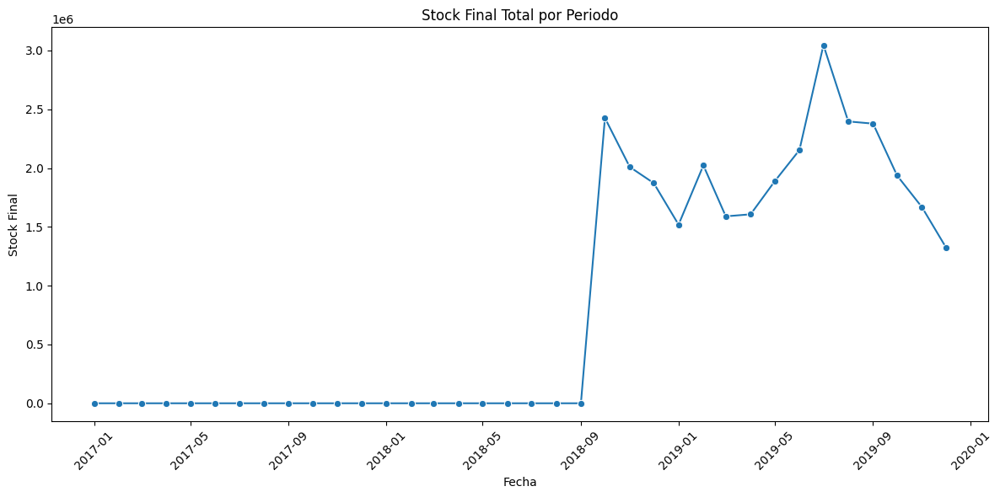

In [41]:
df['periodo_dt'] = pd.to_datetime(df['periodo'].astype(str), format='%Y%m')
stock_por_periodo = df.groupby('periodo_dt')['stock_final'].sum().reset_index()
import matplotlib.pyplot as plt
import seaborn as sns

plt.figure(figsize=(12,6))
sns.lineplot(data=stock_por_periodo, x='periodo_dt', y='stock_final', marker='o')
plt.title('Stock Final Total por Periodo')
plt.xlabel('Fecha')
plt.ylabel('Stock Final')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()


In [55]:
df['stock_ratio'] = df['tn'] / df['stock_final']
df['stock_ratio'] = df['stock_ratio'].replace([np.inf, -np.inf], 0).fillna(0)
mask = (df['product_id'] == 20001) & (df['periodo'] > 201808) & (df['stock_ratio'] > 0)
df[mask][['periodo','product_id','stock_ratio']]

,periodo,product_id,stock_ratio
1849005,201810,20001,0.183089
1849006,201810,20001,7.286950
1849007,201810,20001,1.025965
1849008,201810,20001,0.008322
1849009,201810,20001,0.007324
...,...,...,...
2909818,201912,20001,0.105990
2909819,201912,20001,0.003533
2909820,201912,20001,0.001606
2909821,201912,20001,0.000482


# Analizar Envases

Habra tendencia a comprar productos mas chicos?



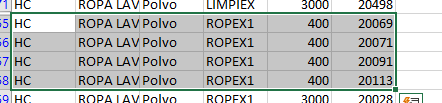

¿y esto como se come? mismo cat1, cat2, cat3, brand y sku_size, pero distinto product_id

- HC	ROPA LAVADO	Liquido	ARIEL	800	    20427
- HC	ROPA LAVADO	Liquido	ARIEL	3000	20102
- HC	ROPA LAVADO	Liquido	ARIEL	1500	20098
- HC	ROPA LAVADO	Liquido	ARIEL	3000	20001
- HC    ROPA LAVADO	Liquido	ARIEL	1000	20919



In [11]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

def productos_size(df, lista_prods):

    # Filtrar el DataFrame
    df_filtrado = df[df['product_id'].isin(lista_prods)]

    df_agrupado = df_filtrado.groupby(['periodo_dt', 'product_id'])['tn'].sum().reset_index()

    plt.figure(figsize=(12, 6))

    for producto in lista_prods:
        datos_producto = df_agrupado[df_agrupado['product_id'] == producto]
        plt.plot(datos_producto['periodo_dt'], datos_producto['tn'], label=f'Producto {producto}')

    plt.title('Evolución de Toneladas por Producto')
    plt.xlabel('Periodo')
    plt.ylabel('Toneladas (tn)')
    plt.legend()
    plt.grid(True)
    plt.xticks(rotation=45)
    plt.tight_layout()
    plt.show()

Se sigue comprando el producto estrella.

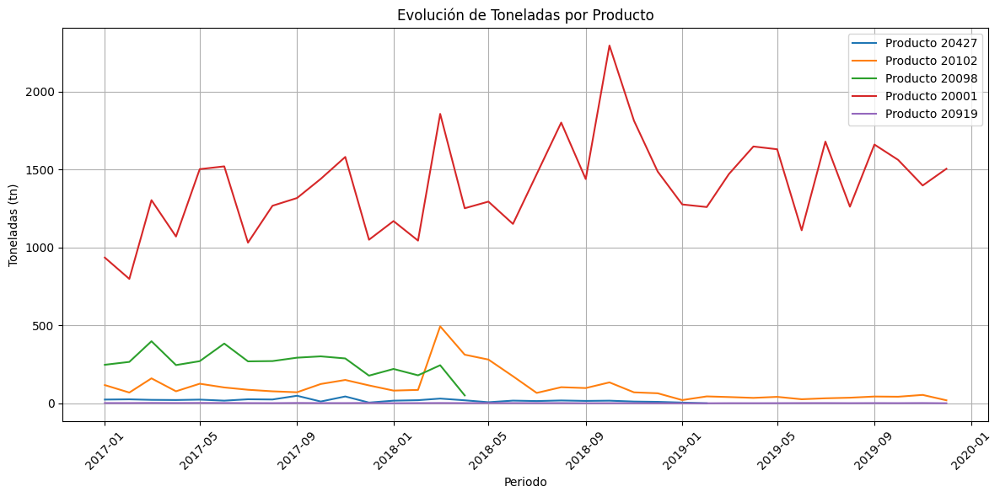

In [12]:
 # Lista de productos a graficar
productos_size(df, [20427, 20102, 20098, 20001, 20919])

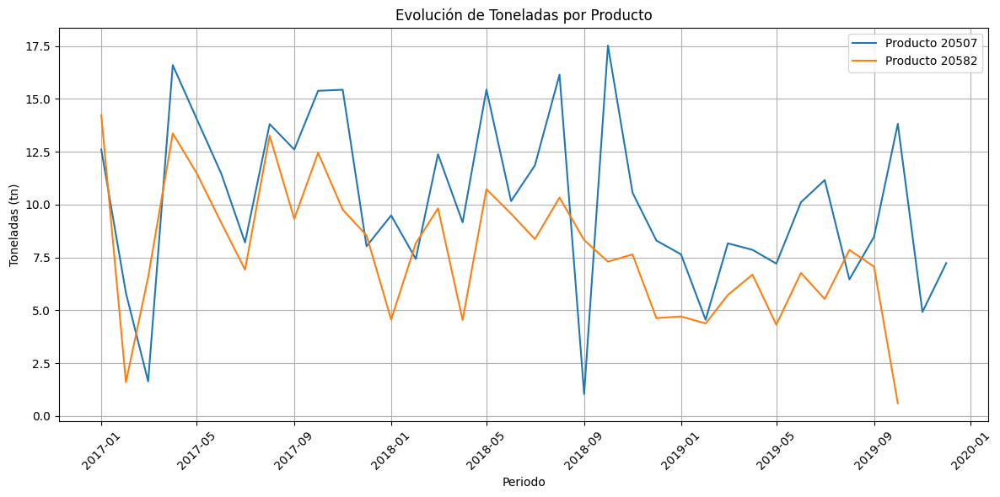

In [13]:
 # Lista de productos a graficar
productos_size(df, [20507,20582])

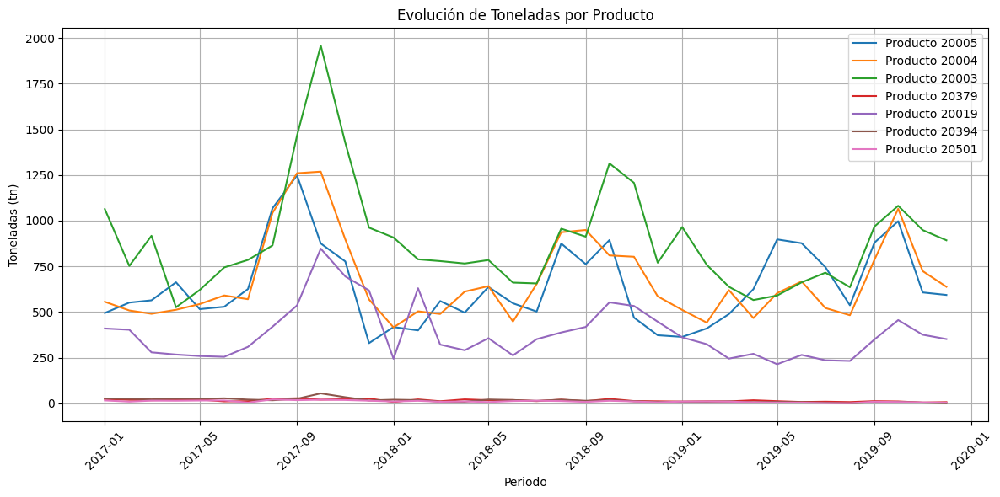

In [21]:
p = [20005,20004,20003,20379,20019,20394,20501]
productos_size(df, p)

### que prductos tienen mas de una sku_size?

In [ ]:
# 1. Agrupar y contar sku_size distintos
df_grouped = (
    df.groupby(['cat1', 'cat2', 'cat3', 'brand'])
    .agg({'sku_size': pd.Series.nunique})  # Cuenta valores únicos
    .reset_index()
    .rename(columns={'sku_size': 'count_sku_sizes'})
)

# 2. Filtrar grupos con más de 1 sku_size
df_filtered = df_grouped[df_grouped['count_sku_sizes'] > 1]

# 3. Ordenar por cantidad de tamaños (descendente)
df_result = df_filtered.sort_values('count_sku_sizes', ascending=False)

# Mostrar resultado
print(df_result)

      cat1         cat2      cat3     brand  count_sku_sizes
8    FOODS     ADEREZOS  Mayonesa    NATURA               10
69      HC  ROPA LAVADO   Liquido     ARIEL                9
11   FOODS     ADEREZOS   Mostaza  MOSTAZA1                9
73      HC  ROPA LAVADO     Polvo     ARIEL                8
70      HC  ROPA LAVADO   Liquido   LIMPIEX                8
..     ...          ...       ...       ...              ...
106     PC      CABELLO   Styling    GOMINA                2
109     PC       DENTAL     CREMA   COLGATE                2
110     PC       DENTAL  Cepilllo   COLGATE                2
34      HC        HOGAR      Baño    AYUDIN                2
152    REF           TE  Especial  TWININGS                2

[93 rows x 5 columns]


In [40]:
# 1. Seleccionar las columnas que definen un producto único
columnas_unicas = ['cat1', 'cat2', 'cat3', 'brand', 'sku_size']

# 2. Contar combinaciones únicas (productos reales distintos)
productos_unicos = df[columnas_unicas].drop_duplicates()
cantidad_productos_reales = len(productos_unicos)

print(f"✅ Cantidad real de productos únicos: {cantidad_productos_reales}")
print(f"📊 Cantidad original de product_id: {df['product_id'].nunique()}")

✅ Cantidad real de productos únicos: 392
📊 Cantidad original de product_id: 1233


# Dataset <periodo, cliente, producto>

Vale la pena predecir aquellos clientes que compraron una sola vez? No en los ultimos 3 meses, sino mas anteriormente. Rta: No borra nada!!!!

Como podemos saber si un producto esta discontinuado?
Cuando dejaron de haber ventas del mismo para siempre.

Estamos hablando se sell-in, que son las ventas de La Multinacional a sus clientes (cadenas de supermercados, mayoristas, distribuidores). No hablamos del sell-out que son las ventas a consumidor final.

La Multinacional da la bienvenida a tu idea de incorporar esos factores externos y que les expliques como afectan a sus ventas

Pablo Cablinski: Buen día.
Consulto porque ayer me quedó una duda respecto a la generación de filas en cero para sell in. Entiendo que es conveniente generar registros con valor cero para evitar "huecos" en las combinaciones de customer_id y product_id durante los períodos en que ambos están activos.
Mi pregunta es:
Si un customer_id nunca compró un determinado producto, ¿igualmente conviene generar registros en cero para todos los períodos en los que ese cliente estuvo activo?
Y, en caso de que así sea, ¿aunque el producto haya tenido ventas solo en un período y el cliente también estuvo activo en ese mismo período, igual se beneficia el análisis al agregar ese registro en cero?Gustavo Denicolay: @Pablo Cablinski 
 Si un customer_id nunca compró un determinado producto, ¿igualmente conviene generar registros en cero para todos los períodos en los que ese cliente estuvo activo? 
AfirmativoGustavo Denicolay: @Pablo Cablinski 
Y, en caso de que así sea, ¿aunque el producto haya tenido ventas solo en un período y el cliente también estuvo activo en ese mismo período, igual se beneficia el análisis al agregar ese registro en cero?
AfirmativoGustavo Denicolay: @Pablo Cablinski 
Racional  a los dos  "Afirmativo"  previos

Si se decide utilizar solamente las 800 series de tiempo en forma individual,  ya sea para un algoritmo de la Estadistica Clasica como ARIMA  o uno de Deep Learning ,  en realidad eshacer un loop que genere 800 modelos. Ahi la informacion extra no cuenta.
Si se decide utilzar un algoritmo como LightGBM es necesaria  crear un dataset estructurado a partir de las series de tiempo, y cada registro sera un   < periodo, customer_id, product_id,   multiples_campos_historicos_derivados,  informacion_externa>.   En este caso,  cada registro cuenta,  cada bit de informacion va a ayudar al LightGBM a predecir mejor, incluso un  cliente que vivio un solo mes y decidio no comprar un producto ese unico mes de efimera vida.  Ese registro contribuira a la "probabilidad de compra" al  "monto promedio comprado"  al considerarse con los datos de otros clientes ya establecidos
Gustavo Denicolay: @Pablo Cablinski 
No le quites posibilidad de aprender al algortimo  cercenando el dataset !
No le quites datos outliers
No le quites el mes malo de 2019-08  si  existe la ingeniosa posibilidad de marcarlo como "problematico"
Se ingenioso en como incorporar a medias y lags a las ventas de un mes problematico,  aunque ello demande crear mas campos

Tendria que:
- Clientes: para cada mes, buscar cuales son todos los clientes anteriores y de este mes.
- Productos: para cada tabla, armar <producto, fecha_inicio, fecha_fin>

In [79]:
import pandas as pd
import numpy as np
from itertools import product

In [93]:
# Suponemos que ya tenés cargado tu DataFrame `df` con columnas: periodo (AAAAMM), customer_id, product_id, tn
# Convertimos periodo a datetime
df["periodo_dt"] = pd.to_datetime(df["periodo"].astype(str), format="%Y%m")

# Paso 2: Determinar periodo de vida útil de cada producto
vida_producto = df.groupby("product_id")["periodo_dt"].agg(["min", "max"]).reset_index()

vida_producto.head()

,product_id,min,max
0,20001,2017-01-01,2019-12-01
1,20002,2017-01-01,2019-12-01
2,20003,2017-01-01,2019-12-01
3,20004,2017-01-01,2019-12-01
4,20005,2017-01-01,2019-12-01


In [94]:
# Expandimos cada producto con todos los periodos de su vida útil
periodos_producto = []
for _, row in vida_producto.iterrows():
    periodos = pd.date_range(start=row["min"], end=row["max"], freq="MS")
    for p in periodos:
        periodos_producto.append((p, row["product_id"]))
df_producto_periodo = pd.DataFrame(periodos_producto, columns=["periodo_dt", "product_id"])
df_producto_periodo.tail()

,periodo_dt,product_id
31517,2017-01-01,21295
31518,2017-08-01,21296
31519,2017-01-01,21297
31520,2017-08-01,21298
31521,2017-08-01,21299


In [96]:
# Paso 3: Clientes activos acumulados hasta cada mes
clientes_por_periodo = df.groupby("periodo_dt")["customer_id"].unique().to_dict()
clientes_acumulados = set()
clientes_periodo_total = {}
for p in sorted(clientes_por_periodo.keys()):
    clientes_acumulados.update(clientes_por_periodo[p])
    clientes_periodo_total[p] = list(clientes_acumulados)


In [92]:
df_producto_periodo = pd.DataFrame(periodos_producto, columns=["periodo_dt", "product_id"])
df_producto_periodo.groupby("periodo_dt")

In [ ]:
# Paso 4: Generar combinaciones <periodo, producto, cliente>
combinaciones = []
for p, grupo in df_producto_periodo.groupby("periodo_dt"):
    clientes = clientes_periodo_total.get(p, [])
    for product_id in grupo["product_id"]:
        for customer_id in clientes:
            combinaciones.append((p, product_id, customer_id))
df_completo = pd.DataFrame(combinaciones, columns=["periodo_dt", "product_id", "customer_id"])

In [ ]:
############## ANTES QUE NADA SUMARIZAR POR PERIODO, CUSTOMER_ID Y PRODUCT_ID LAS TN #######################
df_agrupado = df.groupby(['periodo', 'customer_id', 'product_id'])['tn'].sum().reset_index()




# Suponemos que ya tenés cargado tu DataFrame `df` con columnas: periodo (AAAAMM), customer_id, product_id, tn
# Convertimos periodo a datetime
df["periodo_dt"] = pd.to_datetime(df["periodo"].astype(str), format="%Y%m")

# Paso 1: Rango de periodos disponibles
# todos_los_periodos = pd.date_range(start=df["periodo_dt"].min(), end=df["periodo_dt"].max(), freq="MS")

# Paso 2: Determinar periodo de vida útil de cada producto
vida_producto = df.groupby("product_id")["periodo_dt"].agg(["min", "max"]).reset_index()

# Expandimos cada producto con todos los periodos de su vida útil
periodos_producto = []
for _, row in vida_producto.iterrows():
    periodos = pd.date_range(start=row["min"], end=row["max"], freq="MS")
    for p in periodos:
        periodos_producto.append((p, row["product_id"]))
df_producto_periodo = pd.DataFrame(periodos_producto, columns=["periodo_dt", "product_id"])

# Paso 3: Clientes activos acumulados hasta cada mes
clientes_por_periodo = df.groupby("periodo_dt")["customer_id"].unique().to_dict()
clientes_acumulados = set()
clientes_periodo_total = {}
for p in sorted(clientes_por_periodo.keys()):
    clientes_acumulados.update(clientes_por_periodo[p])
    clientes_periodo_total[p] = list(clientes_acumulados)

# Paso 4: Generar combinaciones <periodo, producto, cliente>
combinaciones = []
for p, grupo in df_producto_periodo.groupby("periodo_dt"):
    clientes = clientes_periodo_total.get(p, [])
    for product_id in grupo["product_id"]:
        for customer_id in clientes:
            combinaciones.append((p, product_id, customer_id))
df_completo = pd.DataFrame(combinaciones, columns=["periodo_dt", "product_id", "customer_id"])

# Paso 5: Unir con las toneladas efectivamente vendidas (tn)
df_merge = df_completo.merge(df[["periodo_dt", "product_id", "customer_id", "tn"]],
                             on=["periodo_dt", "product_id", "customer_id"],
                             how="left")
df_merge["tn"] = df_merge["tn"].fillna(0)

# Paso 6: Recuperar periodo AAAAMM si lo necesitás
df_merge["periodo"] = df_merge["periodo_dt"].dt.strftime("%Y%m").astype(int)

# Resultado final
df_final = df_merge[["periodo", "product_id", "customer_id", "tn"]]

# Ejemplo de vista previa
df_final.head()


,periodo,product_id,customer_id,tn
0,201701,20001,10240,0.00000
1,201701,20001,10241,0.00000
2,201701,20001,10242,0.22386
3,201701,20001,10243,0.00000
4,201701,20001,10244,0.00000


In [ ]:
df_final.final

(17173448, 4)

In [122]:
df.columns

Index(['periodo', 'customer_id', 'product_id', 'plan_precios_cuidados',
       'cust_request_qty', 'cust_request_tn', 'tn', 'cat1', 'cat2', 'cat3',
       'brand', 'sku_size', 'stock_final', 'periodo_dt', 'año', 'stock_ratio',
       'stock_growth', 'stock_level'],
      dtype='object')

In [118]:
df_final = df_final.merge(df[["periodo", "product_id", "customer_id", "tn", "plan_precios_cuidados", "cust_request_qty", "cust_request_tn"]],
                             on=["periodo", "product_id", "customer_id"],
                             how="left")
df_final.shape

(17173448, 8)

In [124]:
df_final = df_final.merge(productos_clean[["product_id", "cat1", "cat2", "cat3", "brand", "sku_size"]],
                             on=["product_id"],
                             how="left")
df_final.shape

(17173448, 13)

In [125]:
stocks.columns

Index(['periodo', 'product_id', 'stock_final'], dtype='object')

In [127]:
df_final = df_final.merge(stocks[["product_id", "periodo", "stock_final"]],
                             on=["periodo", "product_id"],
                             how="left")
df_final.shape

(17173448, 14)

In [128]:
df_final.to_csv('./datasets/df_final.csv', sep=',', index=False)

In [144]:
df_final[df_final['periodo'] == 201701]['customer_id'].nunique()

433

In [143]:
mask = df['periodo'] == 201701
df[mask]['customer_id'].nunique()

433

# Periodo de productos: min max

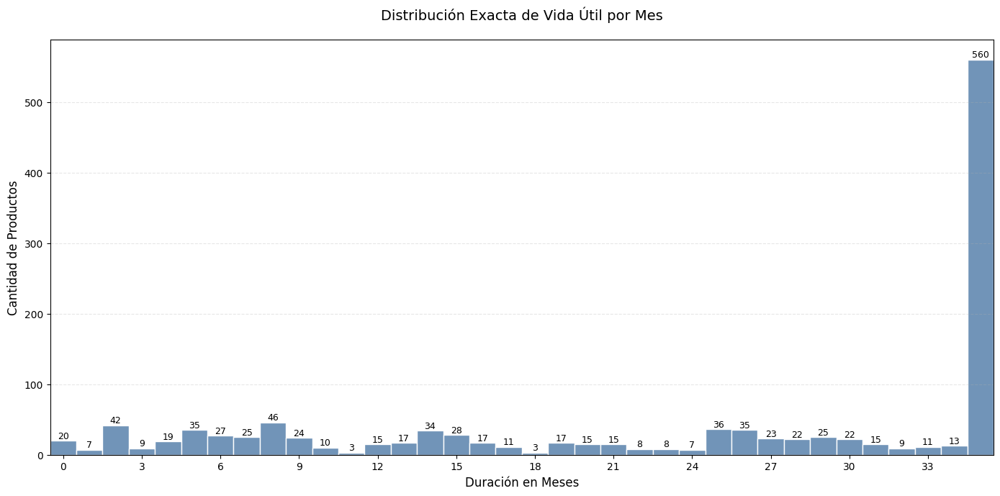

In [146]:
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
# Suponemos que ya tenés cargado tu DataFrame df con columnas: periodo (AAAAMM), customer_id, product_id, tn
# Convertimos periodo a datetime
df["periodo_dt"] = pd.to_datetime(df["periodo"].astype(str), format="%Y%m")

# Paso 2: Determinar periodo de vida útil de cada producto
vida_producto = df.groupby("product_id")["periodo_dt"].agg(["min", "max"]).reset_index()


# Función para calcular meses exactos
def meses_entre_fechas(f1, f2):
    return (f2.year - f1.year) * 12 + (f2.month - f1.month)

# Calcular duración en meses exactos
vida_producto['duracion_meses'] = vida_producto.apply(
    lambda x: meses_entre_fechas(x['min'], x['max']), 
    axis=1
)


# Calcular duración máxima en meses (asegurando cubrir todo el rango)
max_meses = vida_producto['duracion_meses'].max()
bins = int(max_meses) + 1  # +1 para incluir el último mes

# Crear el gráfico con bins exactos por mes
plt.figure(figsize=(14, 7))
ax = sns.histplot(
    data=vida_producto,
    x='duracion_meses',
    bins=bins,  # ¡Ajuste clave aquí!
    discrete=True,  # Para que cada barra sea un mes entero
    color='#4e79a7',
    edgecolor='white',
    alpha=0.8
)

# Añadir etiquetas a las barras
for p in ax.patches:
    height = p.get_height()
    if height > 0:
        ax.annotate(
            f'{int(height)}',
            (p.get_x() + p.get_width() / 2., height),
            ha='center', va='center',
            xytext=(0, 5),
            textcoords='offset points',
            fontsize=9
        )

# Personalización avanzada
plt.title('Distribución Exacta de Vida Útil por Mes', pad=20, fontsize=14)
plt.xlabel('Duración en Meses', fontsize=12)
plt.ylabel('Cantidad de Productos', fontsize=12)
plt.xticks(np.arange(0, max_meses + 1, step=3))  # Muestra cada 3 meses
plt.grid(axis='y', linestyle='--', alpha=0.3)

# Ajustar ejes
ax.set_xlim(-0.5, max_meses + 0.5)  # Margen para visualización

plt.tight_layout()
plt.show()

In [155]:
vida_producto[vida_producto['max']>='2019-10-01'].shape

(959, 4)

# ¿Cuales son los 750 productos a predecir?

In [ ]:
# Suponiendo que tienes una columna de fecha (ej: 'periodo_dt')
fecha_maxima = df['periodo_dt'].max()
fecha_corte = fecha_maxima - pd.DateOffset(months=3)  # Resta exactamente 3 meses
# Agrupar por producto y encontrar su primera fecha de venta
primeras_ventas = df.groupby('product_id')['periodo_dt'].min().reset_index()
primeras_ventas.rename(columns={'periodo_dt': 'primera_fecha_venta'}, inplace=True)

# Filtrar productos cuya primera venta es >= fecha_corte
productos_nuevos = primeras_ventas[primeras_ventas['primera_fecha_venta'] >= fecha_corte]
df_productos_nuevos = df[df['product_id'].isin(productos_nuevos['product_id'])]

print(f"📅 Fecha de corte (hace 3 meses): {fecha_corte}")
print(f"🔍 Productos nuevos encontrados: {len(productos_nuevos)}")
print("📝 Ejemplo de productos nuevos:")
print(productos_nuevos.head())

In [68]:
mask = (df['tn']>0) & (df['periodo'] == 201912)
df[mask][['product_id']].nunique()

product_id    927
dtype: int64

# Clientes chicos

In [73]:
dfc = df.groupby(['customer_id'])['tn'].sum().reset_index().sort_values(by='tn', ascending=False)
dfc.tail(1)


,customer_id,tn
596,10637,0.00288


In [72]:
compras = df[df['customer_id']==10611].groupby(['periodo','customer_id'])['tn'].sum().reset_index().sort_values(by='tn', ascending=False)
compras

,periodo,customer_id,tn
0,201701,10611,0.72393
1,201705,10611,0.66474
2,201706,10611,0.54832
4,201710,10611,0.19047
5,201711,10611,0.07688
3,201707,10611,0.04586


# Excel

In [35]:
import pandas as pd

# Seleccionar columnas deseadas
columnas = ['cat1', 'cat2', 'cat3', 'brand', 'sku_size', 'product_id']
df_export = productos[columnas].drop_duplicates().sort_values(by=columnas)

# Reemplazar valores repetidos por cadena vacía (""), para simular jerarquía
df_export[['cat1', 'cat2', 'cat3']] = df_export[['cat1', 'cat2', 'cat3']].mask(
    df_export[['cat1', 'cat2', 'cat3']].eq(df_export[['cat1', 'cat2', 'cat3']].shift())
)

# Exportar a Excel
df_export.to_excel("productos_jerarquico.xlsx", index=False)


In [45]:

# Seleccionar columnas deseadas y eliminar duplicados
df_simple = df[['cat1', 'cat2', 'cat3', 'brand', 'sku_size', 'product_id']].drop_duplicates()

# Exportar a Excel
df_simple.to_excel("catalogo_productos_simple.xlsx", index=False)
